In [1]:
from model.Autoencoder import Model
import pandas as pd
import warnings
from matplotlib import pyplot as plt
import numpy as np
warnings.filterwarnings('ignore')

## Preprocessing

In [2]:
def _read_data(path):
    df = pd.read_csv(path).iloc[-100000:]
    df['Date'] = pd.to_datetime(df['Timestamp'], unit='s')
    df.set_index('Date', inplace=True)
    df = df[['Open', 'High', 'Low', 'Close', 'Volume_(BTC)', 'Weighted_Price']].rename(columns={'Volume_(BTC)': 'Volume'})
    missing_before = df.isnull().sum().to_numpy()
    df.fillna(method='ffill', inplace=True)
    missing_after = df.isnull().sum().to_numpy()
    return df, missing_before, missing_after

In [3]:
df, missing_before, missing_after = _read_data("btc.csv")

In [4]:
df.head()

,Open,High,Low,Close,Volume,Weighted_Price
Date,,,,,,
2021-01-20 13:21:00,34379.61,34379.61,34202.71,34280.81,26.173612,34256.666368
2021-01-20 13:22:00,34276.37,34338.75,34245.21,34338.75,2.263786,34281.454865
2021-01-20 13:23:00,34335.18,34376.52,34287.40,34376.52,22.712301,34302.817584
2021-01-20 13:24:00,34354.86,34422.89,34344.75,34378.01,4.494266,34378.176105
2021-01-20 13:25:00,34362.78,34482.90,34362.78,34441.10,1.558702,34409.869899


In [5]:
pd.DataFrame([missing_before, missing_after], index=['before', 'after'], columns=df.columns)

,Open,High,Low,Close,Volume,Weighted_Price
before,131,131,131,131,131,131
after,0,0,0,0,0,0


In [24]:
# Only Close and Volume variables will be used in the model for this case.
nn = Model(df, columns=['Close', 'Volume'])
nn

Model(dataframe=df, columns=ListWrapper(['Close', 'Volume']), time_steps=5, KFilter_covariance=0.1, learning_rate=0.0001)

## Kalman Filter Applied vs. Original Data Plotly Chart

In [7]:
nn.train_split()
nn.plot_kfilter()

Train shape: (95000, 3), Test shape: (5000, 2)


## Preprocess and building model

In [8]:
nn.scaling()
nn.prepare_data()
nn.build_model()

X_train Shape: (94995, 5, 2), X_test Shape: (4995, 5, 2)


In [9]:
nn.model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_layer (LSTM)          (None, 5, 512)            1054720   
                                                                 
 encoding_layer_1 (LSTM)     (None, 5, 256)            787456    
                                                                 
 encoding_layer_2 (LSTM)     (None, 128)               197120    
                                                                 
 repeat_vector (RepeatVector  (None, 5, 128)           0         
 )                                                               
                                                                 
 decoding_layer_1 (LSTM)     (None, 5, 128)            131584    
                                                                 
 decoding_layer_2 (LSTM)     (None, 5, 256)            394240    
                                                        

## Initiate training session
PS: Since the model instance seeks for a cached model first, it loads the stored model instead of initiating a new one.

In [10]:
nn.train_model(epochs=250, verbose=1)

Model: 512-256-128seq_250eps_128bs_5ts_0.1KFconst-Close, Volume is loaded!


In [11]:
nn.save_model()

Another model with the same name was already saved... Use override arg to proceed


## Predicts test data

In [ ]:
nn.predict_test()

In [13]:
nn.plot_anomaly(prominence=150, distance=50)
nn.close_vs_loss()

## Predict anomaly in a given sequence

In [14]:
df, _, _ = _read_data("btc.csv")

In [22]:
def get_prediction(dataframe, date_string, prominence=70):
    dataframe = dataframe.reset_index().reset_index()
    dataframe.set_index('Date', inplace=True)
    idx = int(dataframe.loc[date_string, 'index'])
    df = dataframe.iloc[max(idx-50, 5): idx + 1]
    df.drop(columns=["index"], inplace=True)
    df_ = df.append([np.nan, np.nan, np.nan, np.nan], ignore_index=False).fillna(method="ffill").drop(columns=[0])
    anomaly_indices, loss = nn.predict(df_.copy(), prominence=prominence)
    loss = loss[:-4]
    df_ = df.copy()[5:]
    df_anomalies = pd.DataFrame(loss, columns=['loss'])
    df_anomalies['Date'] = df_.index.strftime('%m-%d %H:%M')
    df_anomalies["index"] = df_.index
    df_anomalies.set_index("index", inplace=True)
    df_anomalies['Close'] = df_['Close']
    df_anomalies.reset_index(inplace=True)
    df_anomalies['anomaly'] = False
    df_anomalies.iloc[anomaly_indices, df_anomalies.columns.get_loc('anomaly')] = True

    fig, ax1 = plt.subplots()

    color = 'tab:red'
    ax1.set_xlabel('time (s)')
    ax1.set_ylabel('loss', color=color)
    ax1.plot(df_anomalies['Date'], df_anomalies['loss'], color = "red")
    ax1.scatter(df_anomalies.query("anomaly == True").index, df_anomalies.query("anomaly == True")['loss'])
    ax1.tick_params(axis='y', labelcolor=color)
    plt.xticks(rotation=90)

    ax2 = ax1.twinx()

    color = 'tab:blue'
    ax2.set_ylabel('close', color=color)
    ax2.plot(df_anomalies['Date'], df_anomalies['Close'])
    ax2.tick_params(axis='y', labelcolor=color)
    plt.xticks(rotation=90)
    fig.tight_layout()
    plt.show()

    return df_anomalies.iloc[-1]['anomaly']

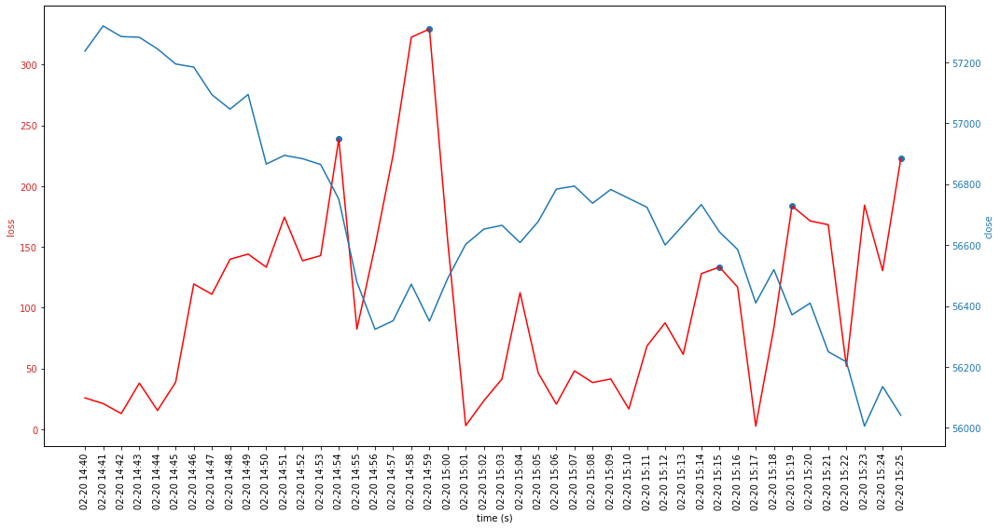

In [23]:
prediction = get_prediction(df, "2021-02-20 15:25:00", 120)

Functions returns True if the last data point (**2021-02-20 15:25:00** in this case) in the dataframe is anomalous, False otherwise.

In [17]:
if prediction:
    print("Given sequence indicates anomaly!")

else:
    print("Given sequence does not imply anomality...")

Given sequence indicates anomaly!
